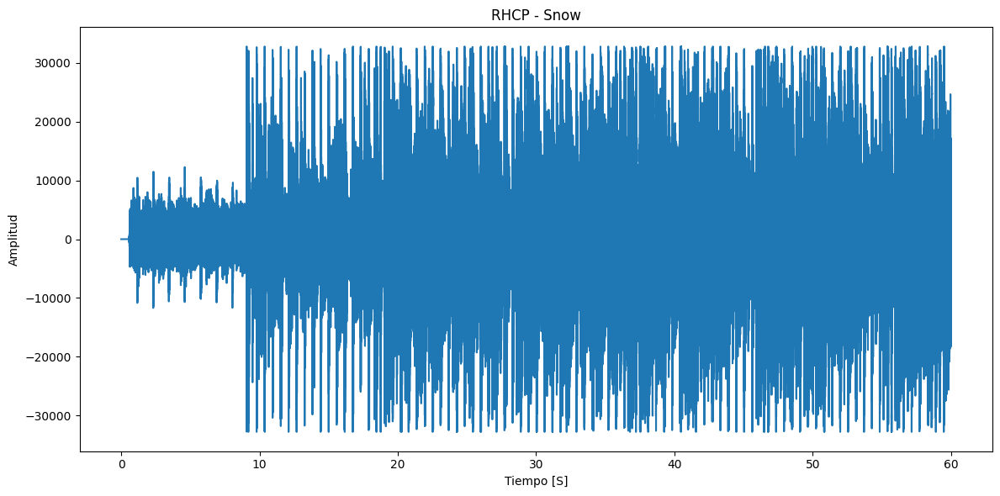

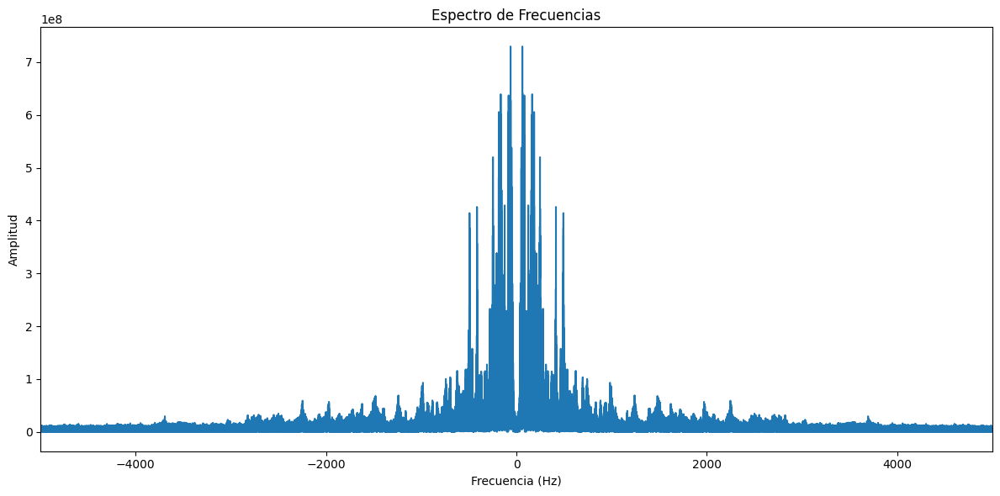

Audio RHCP - Snow (Primer minuto)


In [2]:
from IPython.display import Audio
from scipy.io.wavfile import read
import matplotlib.pyplot as plt
import numpy as np

fs1, data1 = read('Red Hot Chili Peppers - Snow.wav')

# Convertir el audio estéreo a mono
if len(data1.shape) > 1:
    data1 = np.mean(data1, axis=1)

# Recortar a un minuto
data1 = data1[:fs1*60]

time1 = np.arange(0, float(len(data1))/fs1, 1.0/fs1)

plt.figure(figsize=(12, 6))
plt.plot(time1, data1)
plt.title("RHCP - Snow")
plt.ylabel("Amplitud")
plt.xlabel("Tiempo [S]")

plt.tight_layout()
plt.show()

# Calcular la DFT
dft_data1 = np.fft.fft(data1)

# Calcular las frecuencias para el eje x
freqs = np.fft.fftfreq(len(data1), 1/fs1)

# Reordenar las frecuencias y la DFT
freqs_shifted = np.fft.fftshift(freqs)
dft_data1_shifted = np.fft.fftshift(dft_data1)

# Graficar el espectro de frecuencias
plt.figure(figsize=(12, 6))
plt.plot(freqs_shifted, np.abs(dft_data1_shifted))
plt.title("Espectro de Frecuencias")
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Amplitud")
plt.xlim(-5000, 5000)
plt.tight_layout()
plt.show()


print("Audio RHCP - Snow (Primer minuto)")
Audio(data1, rate=fs1) # para escuchar la señal, si se desea

Como puede verse, el audio, tiene mayor magnitud en las bajas frecuencias, por lo que si el proceso de filtrado se hace al rededor de estos puntos, se veran cambios significativos. 

In [3]:
# Calcular la magnitud del espectro
magnitude = np.abs(dft_data1)

# Encontrar el índice de la magnitud máxima
max_index = np.argmax(magnitude)

# Encontrar la frecuencia correspondiente
max_freq = freqs[max_index]

print("La frecuencia de mayor magnitud es:", max_freq, "Hz")

La frecuencia de mayor magnitud es: 61.949999999999996 Hz


In [4]:
# Duración del sonido
duration = 10.0  # 10 segundos

# Generar una señal sinusoidal con la frecuencia de mayor magnitud
t = np.linspace(0, duration, int(fs1 * duration), False)
sound = np.sin(max_freq * t * 2 * np.pi)

# Normalizar a 16-bit range
sound *= 32767 / np.max(np.abs(sound))
sound = sound.astype(np.int16)

# Reproducir el sonido
Audio(sound, rate=fs1)

<h2>Parte 2: Diseño y aplicación de filtros FIR<h2>

In [5]:
def ventana(name='Hamming', M=20):
    # Rect/Hanning/Hamming
    if name == 'Hamming':
        window = np.array([0.54 - 0.46 * np.cos(2 * np.pi * n / (M - 1)) for n in range(M)])
    elif name == 'Hanning':
        window = np.array([0.5 - 0.5 * np.cos(2 * np.pi * n / (M - 1)) for n in range(M)])
    elif name == 'Rect':
        window = np.ones(M)
    elif name == 'black':
        window = np.array([0.42-0.5*np.cos((2*np.pi*n)/(M-1))+0.08*np.cos((4*np.pi*n)/(M-1))for n in range(M)])
    return window

In [6]:
def orden_filtro(BW , fs,  name = "Hamming"): # RECIBE EL ANCHO DE BANDA QUE SE QUIERE Y LA VENTANA
    
    bwn=2*np.pi*BW/fs # ancho de banda  normalizado en radianes
    
    if name == 'Hamming':
        M = int((8*np.pi)/bwn) # orden estimado del filtro, ventana Hamming
    elif name == 'Hanning':
        M = int((8*np.pi)/bwn) # orden estimado del filtro , ventana Hanning
    elif name == 'Rect': 
        M = int((4*np.pi)/bwn)-1
    elif name == 'black':
        M = int((12*np.pi)/bwn) # Orden estimado del filtro, ventana blackman
            
    if(M%2==0):  # Validamos si M es par y lo volvemos Impar
        M+=1
    
    return M

In [7]:
def filtro(vector_n, name="pasabajas" , fs = 2000 ,  fc1= 500, fc2= 1000): # n es un vector - array con todos los valores que toma n desde -M hasta M
    
    #Normalizamos y calculamos lo que falta.
    wc1 = (2*np.pi*fc1)/fs
    wc2 = (2*np.pi*fc2)/fs
    fc1 = fc1/fs
    fc2 = fc2/fs
    
    if name == "pasabajas":
        hn  =   np.array([ 2*fc1 * np.sin(wc1*(n))/(wc1*n) if(n!=0) else 2*fc1 for n in vector_n])
    elif  name == "pasaaltas":
        hn  =   np.array([ -(2*fc1 * np.sin(wc1*(n))/(wc1*n)) if(n!=0) else 1-2*fc1 for n in vector_n])
    elif name == "pasabandas":
        hn  =   np.array([ (2*fc2 * np.sin(wc2*(n))/(wc2*n))-(2*fc1 * np.sin(wc1*(n))/(wc1*n))  if(n!=0) else 2*(fc2-fc1) for n in vector_n])
    elif name == "rechazabandas":
        hn  =   np.array([ (2*fc1 * np.sin(wc1*(n))/(wc1*n))-(2*fc2 * np.sin(wc2*(n))/(wc2*n))  if(n!=0) else 1- 2*(fc2-fc1) for n in vector_n])
    
    return hn

<h2>Desarollo</h2>

<p> 1) Se diseñan 4 filtros , pasabaja, pasaalta, pasabanda y rechazabanda, cada uno con una ventana diferente </p>

In [8]:
# DISEÑO DE LOS 4 FILTROS 
fc  = 200    # Primero , se define la frecuencia de corte para el pasabajas y el pasa altas
fs  = 12000  #Segundo , se define la frecuencia de muestreo

# Defino la segunda frecuencia para crear los filtros pasabanda y rechazabanda
fc2 = 800   # Se define asi porque fc < f2 Según la definición de las ecuaciones vistas

BW  = 200    # Ancho de banda en la banda de transicion para todos los filtros

# La funcion orden_filtro me devuelve el valor de M impar
M1 = orden_filtro( BW, fs, "Hamming" ) # Orden para el filtro pasabajas
M2 = orden_filtro( BW, fs, "Hanning" ) # Orden para el filtro pasaaltas
M3 = orden_filtro( BW, fs, "black"   ) # Orden para el filtro pasabandas
M4 = orden_filtro( BW, fs, "Rect"    ) # Orden para el filtro rechazabandas

#Creo el vector n de cada uno de los filtros
#para luego hallar los valores de la respuesta al impulso de la ventana y la sinc
vector_n_1 = np.arange(-(M1-1)/2,(M1-1)/2 + 1)
vector_n_2 = np.arange(-(M2-1)/2,(M2-1)/2 + 1)
vector_n_3 = np.arange(-(M3-1)/2,(M3-1)/2 + 1)
vector_n_4 = np.arange(-(M4-1)/2,(M4-1)/2 + 1)

# Obtengo la respuesta al impulso de la funcion sinc para cada uno de los filtros
hn_pasabajas     = filtro(vector_n_1, name="pasabajas"     , fs = fs ,  fc1 = fc)
hn_pasaaltas     = filtro(vector_n_2, name="pasaaltas"     , fs = fs ,  fc1 = fc)
hn_pasabandas    = filtro(vector_n_3, name="pasabandas"    , fs = fs ,  fc1 = fc, fc2 = fc2)
hn_rechazabandas = filtro(vector_n_4, name="rechazabandas" , fs = fs ,  fc1 = fc, fc2 = fc2)

# Obtengo la respuesta al impulso de las ventanas que escojo para cada filtro
wn_pasabajas     =  ventana(name='Hamming' , M = M1)
wn_pasaaltas     =  ventana(name='Hanning' , M = M2)
wn_pasabandas    =  ventana(name='black'   , M = M3)
wn_rechazabandas =  ventana(name='Rect'    , M = M4)

#Multiplicamos para obtener la respuesta del filtro  h'(n) = h(n)*w(n) TRUNCAMIENTO
h_pasabajas      =  hn_pasabajas*wn_pasabajas 
h_pasaaltas      =  hn_pasaaltas*wn_pasaaltas
h_pasabandas     =  hn_pasabandas*wn_pasabandas
h_rechazabandas  =  hn_rechazabandas*wn_rechazabandas

In [9]:
import scipy.signal as signal # para la calcular la transformada

N = 2048 # Numero de puntos de la FFT
# Hallamos la respuesta en frecuencia de cada filtro
w_pasabajas     , Hh_pasabajas     = signal.freqz(h_pasabajas  ,   1, whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado
w_pasaaltas     , Hh_pasaaltas     = signal.freqz(h_pasaaltas ,    1, whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado
w_pasabandas    , Hh_pasabandas    = signal.freqz(h_pasabandas,    1, whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado
w_rechazabandas , Hh_rechazabandas = signal.freqz(h_rechazabandas, 1, whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado

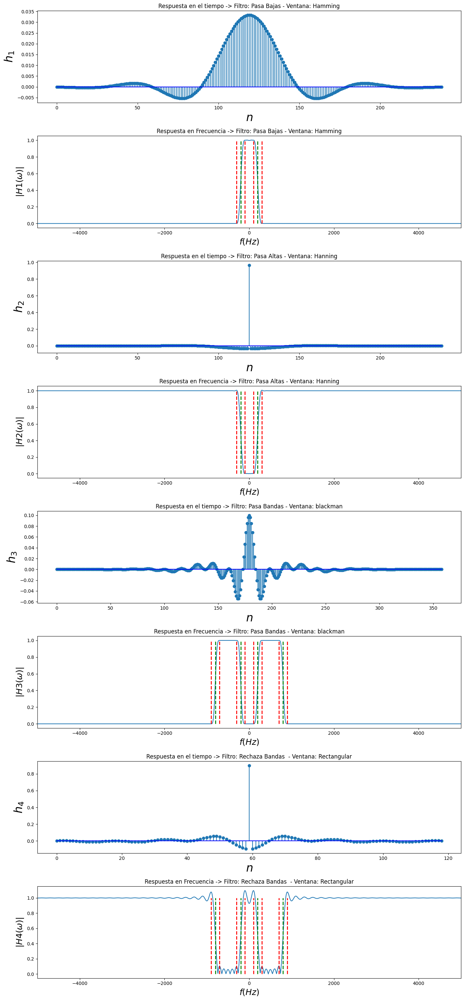

In [10]:
plt.figure(figsize=(14,30))
#PASA BAJAS TIEMPO
plt.subplot(811)
plt.stem(vector_n_1 + ((M1-1)/2),h_pasabajas ,basefmt='b-')
plt.title("Respuesta en el tiempo -> Filtro: Pasa Bajas - Ventana: Hamming")
plt.xlabel("$n$",fontsize=24)
plt.ylabel("$h_1$",fontsize=24)


#PASA BAJAS FRECUENCIA
plt.subplot(812)
plt.plot((w_pasabajas-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh_pasabajas))) # Grafico en frecuencia
plt.vlines([-fc,fc],0,1,color='g',lw=2.,linestyle='--')
plt.vlines([-fc-BW/2,-fc+BW/2,fc-BW/2 ,fc+BW/2],0,1,color='r',lw=2.,linestyle='--')
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.title("Respuesta en Frecuencia -> Filtro: Pasa Bajas - Ventana: Hamming")
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H1(\omega)| $",fontsize=18)
plt.xlim(-5000, 5000)


#PASA ALTAS TIEMPO
plt.subplot(813)
plt.stem(vector_n_2 + ((M2-1)/2),h_pasaaltas  ,basefmt='b-')
plt.title("Respuesta en el tiempo -> Filtro: Pasa Altas - Ventana: Hanning")
plt.xlabel("$n$",fontsize=24)
plt.ylabel("$h_2$",fontsize=24)


#PASA ALTAS FRECUENCIA
plt.subplot(814)
plt.plot((w_pasaaltas-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh_pasaaltas))) # Grafico en frecuencia
plt.vlines([-fc,fc],0,1,color='g',lw=2.,linestyle='--')
plt.vlines([-fc-BW/2,-fc+BW/2,fc-BW/2 ,fc+BW/2],0,1,color='r',lw=2.,linestyle='--')
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.title("Respuesta en Frecuencia -> Filtro: Pasa Altas - Ventana: Hanning")
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H2(\omega)| $",fontsize=18)
plt.xlim(-5000, 5000)


#PASA BANDAS TIEMPO
plt.subplot(815)
plt.stem(vector_n_3 + ((M3-1)/2),h_pasabandas  ,basefmt='b-')
plt.title("Respuesta en el tiempo -> Filtro: Pasa Bandas - Ventana: blackman")
plt.xlabel("$n$",fontsize=24)
plt.ylabel("$h_3$",fontsize=24)


#PASA BANDAS FRECUENCIA
plt.subplot(816)
plt.plot((w_pasabandas-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh_pasabandas))) # Grafico en frecuencia
plt.vlines([-fc,fc],0,1,color='g',lw=2.,linestyle='--')
plt.vlines([-fc2,fc2],0,1,color='g',lw=2.,linestyle='--')
plt.vlines([-fc-BW/2,-fc+BW/2,fc-BW/2 ,fc+BW/2],0,1,color='r',lw=2.,linestyle='--')
plt.vlines([-fc2-BW/2,-fc2+BW/2,fc2-BW/2 ,fc2+BW/2],0,1,color='r',lw=2.,linestyle='--')
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.title("Respuesta en Frecuencia -> Filtro: Pasa Bandas - Ventana: blackman")
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H3(\omega)| $",fontsize=18)
plt.xlim(-5000, 5000)


#RECHAZA BANDAS TIEMPO
plt.subplot(817)
plt.stem(vector_n_4 + ((M4-1)/2),h_rechazabandas  ,basefmt='b-')
plt.title("Respuesta en el tiempo -> Filtro: Rechaza Bandas  - Ventana: Rectangular")
plt.xlabel("$n$",fontsize=24)
plt.ylabel("$h_4$",fontsize=24)


#RECHAZA BANDAS FRECUENCIA
plt.subplot(818)
plt.plot((w_rechazabandas-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh_rechazabandas))) # Grafico en frecuencia
plt.vlines([-fc,fc],0,1,color='g',lw=2.,linestyle='--')
plt.vlines([-fc2,fc2],0,1,color='g',lw=2.,linestyle='--')
plt.vlines([-fc-BW/2,-fc+BW/2,fc-BW/2 ,fc+BW/2],0,1,color='r',lw=2.,linestyle='--')
plt.vlines([-fc2-BW/2,-fc2+BW/2,fc2-BW/2 ,fc2+BW/2],0,1,color='r',lw=2.,linestyle='--')
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.title("Respuesta en Frecuencia -> Filtro: Rechaza Bandas  - Ventana: Rectangular")
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H4(\omega)| $",fontsize=18)
plt.xlim(-5000, 5000)

plt.tight_layout()
plt.show()

# Creación de filtro IRR

### En este punto, se decide implementar un filtro pasa alto y otro paso bajo de tipo butter de orden 4 y cuyas frecuencias de corte han sido tomadas con base a los instrumentos que se deseaban atenuar. 

#### Diseño de los filtros

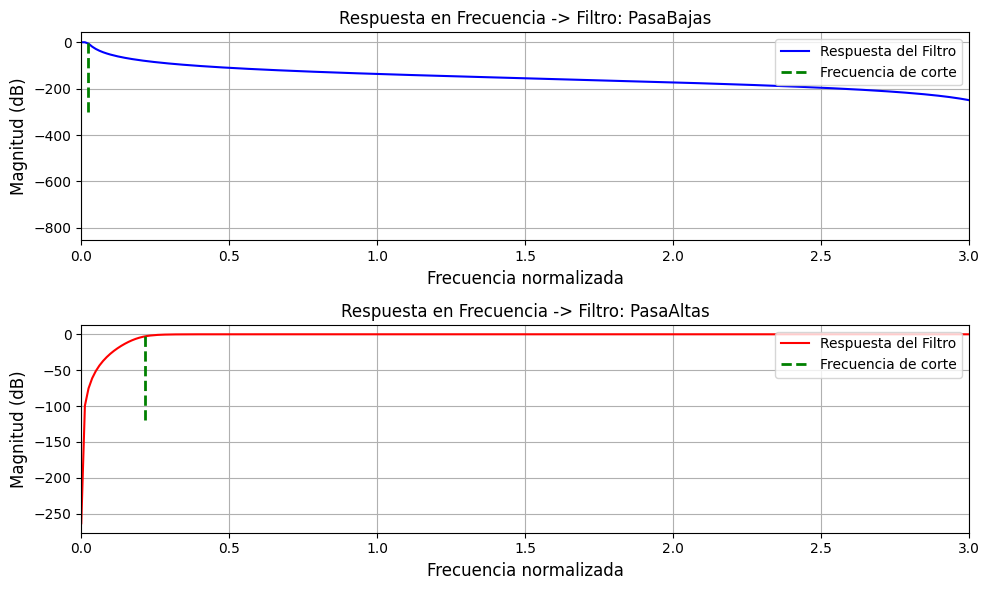

In [14]:
import scipy.signal as sp

# Frecuencia de muestreo
fs = 44100

# Filtrado de la señal pasa bajas
Wn_pasa_baja= 300/fs # Filtro con frecuencia de corte  = 300 Hz, normalizamos
b1, a1 = sp.butter(4, Wn_pasa_baja, btype='low', analog=False, output='ba', fs=None)
wb1, Hb1 = sp.freqz(b1, a1,whole= True);
y = sp.lfilter(b1, a1, data1)

# Filtrado de la señal pasa altas
Wn_pasa_alta = 3000/fs # Filtro con frecuencia de corte  = 3000 Hz, normalizamos
b2, a2  = sp.butter (4, Wn_pasa_alta, btype='highpass', analog=False, output='ba', fs=None)
wb2, Hb2  = sp.freqz (b2, a2,whole= True);
y_pasa_alta = sp.lfilter (b2, a2, data1)

plt.figure(figsize=(10,6))
plt.subplot(211)
plt.plot(wb1, 20 * np.log10(np.abs(Hb1)), 'b', label="Respuesta del Filtro")
plt.vlines([Wn_pasa_baja*np.pi],-300,2,color='g',lw=2.,linestyle='--',label="Frecuencia de corte")
plt.title("Respuesta en Frecuencia -> Filtro: PasaBajas")
plt.xlabel(r"Frecuencia normalizada",fontsize=12)
plt.ylabel(r"Magnitud (dB)",fontsize=12)
plt.legend(loc = "upper right")
plt.xlim(0,3)
plt.grid()

plt.subplot(212)
plt.plot(wb2, 20 * np.log10(np.abs(Hb2)), 'r',label="Respuesta del Filtro")
plt.vlines([Wn_pasa_alta*np.pi],-120,0,color='g',lw=2.,linestyle='--', label="Frecuencia de corte")
plt.title("Respuesta en Frecuencia -> Filtro: PasaAltas")
plt.xlabel(r"Frecuencia normalizada",fontsize=12)
plt.ylabel(r"Magnitud (dB)",fontsize=12)
plt.legend(loc = "upper right")
plt.xlim(0,3)
plt.grid()

plt.tight_layout()
plt.show()

#### Análisis

- Con base a las frecuencias de corte que se han tomado y al escuchar cada uno de los audios se observa que estos tienen el comportamiento esperado. La razón de mostrar las gráficas es con la intención de observa de manera adecuada la respuesta de estos ya que estos son derivados de un filtro analógico.

In [15]:
print("Audio RHCP - Snow (Primer minuto - Pasa Bajas)")
Audio(y , rate=fs1)

Audio RHCP - Snow (Primer minuto - Pasa Bajas)


In [16]:
print("Audio RHCP - Snow (Primer minuto - Paso Alto)")
Audio(y_pasa_alta, rate=fs1)

Audio RHCP - Snow (Primer minuto - Paso Alto)


Coeficientes del filtro digital:
b: [1.29607191e-05 5.18428766e-05 7.77643148e-05 5.18428766e-05
 1.29607191e-05]
a: [ 1.         -3.67388572  5.07378356 -3.12116011  0.72146964]


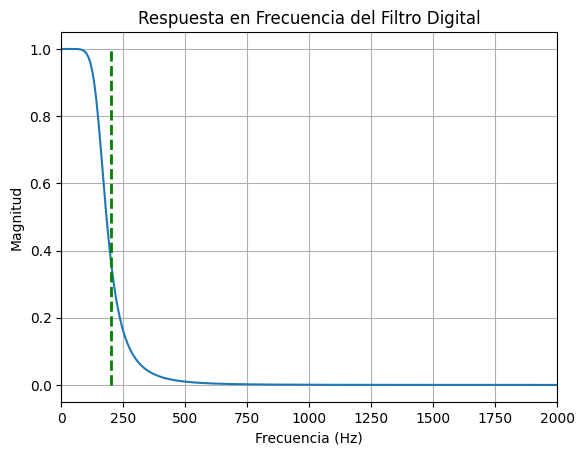

In [26]:
# Parámetros del filtro analógico
order = 4  # Orden del filtro
cutoff_freq =1000# Frecuencia de corte del filtro analógico

# Diseño del filtro analógico
b_analog, a_analog = sp.butter(order, cutoff_freq, btype='low', analog=True, output='ba', fs=None)

# Parámetros del filtro digital
fs = 8000  # Frecuencia de muestreo


# Transformación del filtro analógico al filtro digital
b_digital, a_digital = sp.bilinear(b_analog, a_analog, fs=fs)

# Imprimir los coeficientes del filtro digital
print("Coeficientes del filtro digital:")
print("b:", b_digital)
print("a:", a_digital)


w_diseno, h_diseno = sp.freqz(b_digital, a_digital, whole= True, fs=fs, worN=1024)

# Graficar respuesta en frecuencia

plt.plot(w_diseno-fs/2, np.abs(np.fft.fftshift(h_diseno)))
plt.vlines([200],0,1,color='g',lw=2.,linestyle='--', label="Frecuencia de corte")
plt.title('Respuesta en Frecuencia del Filtro Digital')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Magnitud')
plt.grid()
plt.xlim(0,2000)

plt.show()

In [18]:
y_pasa__baja_diseño = sp.lfilter(b_digital,a_digital,data1)
print("Audio después de pasar por el pasa-bajas: ")
Audio(y_pasa__baja_diseño , rate=fs1) #

Audio después de pasar por el pasa-bajas: 


#### Análisis:
- Como se mencionó anteriormente, se ha diseñado el filtro con la base del filtro analógico; a su vez la frecuencia se toma del orden de los 8KHz con el fin de que el filtro resultante responda con frecuencias de hasta 4KHz. 

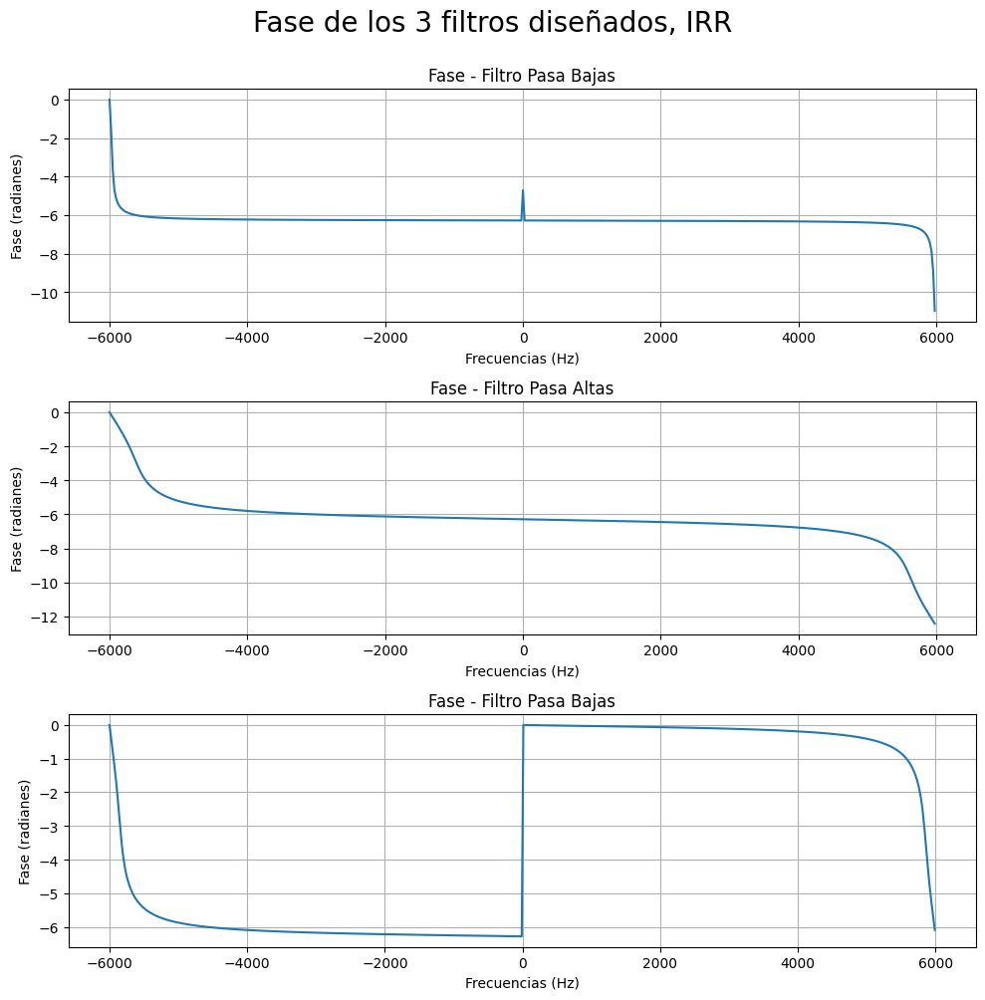

In [20]:
fase_pasabajas_IRR   = np.unwrap(np.angle(Hb1))
fase_pasaaltas_IRR     = np.unwrap(np.angle(Hb2))
fase_pasabajas_IRR2 = np.unwrap(np.angle(h_diseno))

plt.figure(figsize=(10,10))
plt.suptitle("Fase de los 3 filtros diseñados, IRR",fontsize=20, y= 1)
plt.subplot(311)
plt.plot((wb1-np.pi)*fs/(2*np.pi), fase_pasabajas_IRR)
plt.title('Fase - Filtro Pasa Bajas')
plt.ylabel('Fase (radianes)')
plt.xlabel('Frecuencias (Hz)')
plt.grid(True)

plt.subplot(312)
plt.plot((wb2-np.pi)*fs/(2*np.pi), fase_pasaaltas_IRR )
plt.title('Fase - Filtro Pasa Altas')
plt.ylabel('Fase (radianes)')
plt.xlabel('Frecuencias (Hz)')
plt.grid(True)

plt.subplot(313)
plt.plot((w_diseno-fs/2), fase_pasabajas_IRR2)
plt.title('Fase - Filtro Pasa Bajas')
plt.ylabel('Fase (radianes)')
plt.xlabel('Frecuencias (Hz)')
plt.grid(True)


plt.tight_layout()    
plt.show()

#### Análisis

- En cuanto a la fase, podemos evidenciar que esta no es lineal tal y como es de esperarse, dado que la frecuencia esta cambiando. Se puede observar que incluso hay puntos donde pareciera lineal pero sabemos que no puede ser posible porque tambien hay puntos donde cambia de manera abrupta cosa que no sucede en los filtros FIR dado que estos durante todo el rango de frecuencias se mantiene lineal.